In [403]:
import ipyvolume as ipv
import tyssue
import json
import matplotlib.pylab as plt
import numpy as np
import pandas as pd
import random
import sys
import tyssue.io.hdf5 as hdf5
from IPython.display import Image
from scipy import optimize
from tyssue.draw import sheet_view
from tyssue.geometry.planar_geometry import PlanarGeometry as geom

##### Own functions
import src.vertexModel as vertexModel
import src.inputMechanicalParameters as inputMechanicalParameters
import src.auxFunctions as auxFunctions
from tyssue.topology import add_vert
import src.cellDivision as cellDivision


from tyssue.topology.base_topology import add_vert, close_face, collapse_edge, remove_face
from tyssue.topology.base_topology import split_vert as base_split_vert

Topology changed!
Topology changed!


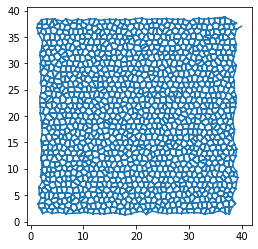

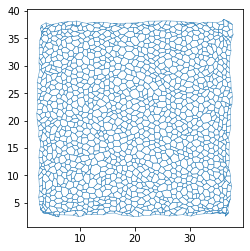

In [404]:
#### Initialize Model
[cellmap_init, geom, energyContributions_model] = vertexModel.initialize()

## Update mechanical parameters
cellmap_init = inputMechanicalParameters.update(cellmap_init)

## Initial stage
energyContributions_model.compute_energy(cellmap_init)

## RUN
[cellmap_H, geom, model_H, history_H] = vertexModel.solveEuler(cellmap_init, geom, energyContributions_model, endTime = 100)


fig, ax = sheet_view(cellmap_H, ['y', 'x'], edge={"color":1, 'colormap': 'Greys'})
#auxFunctions.create_frames(history_H, './results', edge={'color':'black'})
#auxFunctions.exportToMesh(history_H, './results')

import warnings
warnings.filterwarnings("ignore")

In [405]:
cellmap_H.edge_df

,trgt,nz,length,face,srce,dx,dy,sx,sy,tx,...,uy,rx,ry,sub_area,is_active,length_elasticity,prefered_length,uz,length_elasticity_ECM,length_elasticity_FRC
edge,,,,,,,,,,,,,,,,,,,,,
0,14,0.452042,0.807851,1376,7,-0.543594,-0.597603,35.657331,37.875993,35.113737,...,-0.739744,-0.254051,0.552289,0.226021,1,168.351750,0.670697,0.57735,55.204586,113.147164
1,7,0.075217,0.807851,1379,14,0.543594,0.597603,35.113737,37.278391,35.657331,...,0.739744,-0.165521,-0.320337,0.037609,1,168.351750,0.827497,0.57735,55.204586,113.147164
2,15,0.055714,0.366438,1375,14,-0.047031,0.363407,35.113737,37.278391,35.066706,...,0.991729,0.134229,0.147448,0.027857,1,133.114782,0.415405,0.57735,40.298124,92.816658
3,14,0.075217,0.366438,1379,15,0.047031,-0.363407,35.066706,37.641798,35.113737,...,-0.991729,-0.212552,0.043071,0.037609,1,133.114782,0.322947,0.57735,40.298124,92.816658
4,16,0.439324,0.944540,1375,15,-0.905722,-0.267999,35.066706,37.641798,34.160983,...,-0.283735,0.087198,0.510855,0.219662,1,175.379443,0.646340,0.57735,59.520723,115.858720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8119,2756,0.498800,0.791882,731,735,0.554906,-0.564939,25.226213,20.719866,25.781119,...,-0.713413,-0.675742,-0.210932,0.249400,1,144.329285,0.579843,0.57735,43.253414,101.075871
8120,2444,0.472836,0.849767,838,2757,-0.144337,0.837420,22.423895,24.139867,22.279558,...,0.985469,0.566784,-0.012473,0.236418,1,147.125367,0.538481,0.57735,40.750514,106.374853
8121,2757,0.517434,0.849767,877,2444,0.144337,-0.837420,22.279558,24.977287,22.423895,...,-0.985469,-0.624564,0.038718,0.258717,1,160.930271,0.857247,0.57735,55.421233,105.509038


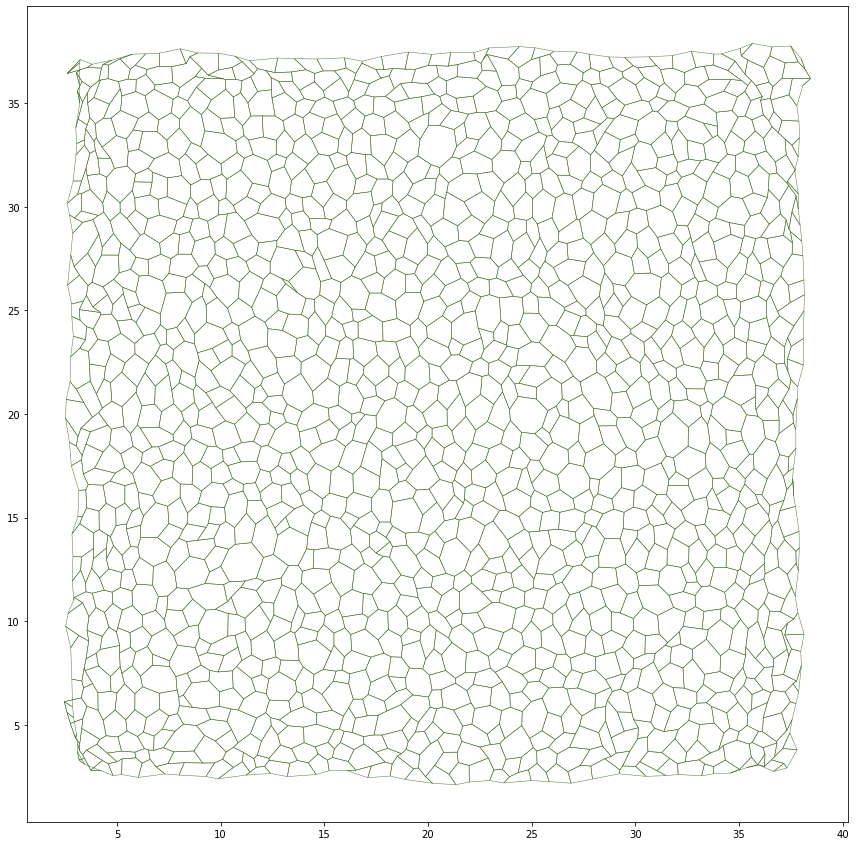

In [406]:
fig, ax = sheet_view(cellmap_H)
fig.set_size_inches((15, 15))
plt.show() 

In [407]:
### match length_elasticity of opposite edges 

for edge in range(len(cellmap_H.edge_df)):
    
    ### find the opposite edge of each edge in edges_list_without_opposites
    
    opposite_edge_indices = cellmap_H.edge_df[
        (cellmap_H.edge_df["srce"] == cellmap_H.edge_df.loc[edge, "trgt"]) &
        (cellmap_H.edge_df["trgt"] == cellmap_H.edge_df.loc[edge, "srce"])
    ].index
    


    if len(opposite_edge_indices):
            # Update the values for the opposite edges
            cellmap_H.edge_df['length_elasticity_ECM'][opposite_edge_indices] = cellmap_H.edge_df['length_elasticity_ECM'][edge] 
            cellmap_H.edge_df['length_elasticity_FRC'][opposite_edge_indices] = cellmap_H.edge_df['length_elasticity_FRC'][edge] 
            cellmap_H.edge_df['length_elasticity'][opposite_edge_indices] = cellmap_H.edge_df['length_elasticity'][edge]

In [408]:
### match prefered_length of opposite edges 


for edge in range(len(cellmap_H.edge_df)):
    
    ### find the opposite edge of each edge in edges_list_without_opposites
    
    opposite_edge_indices = cellmap_H.edge_df[
        (cellmap_H.edge_df["srce"] == cellmap_H.edge_df.loc[edge, "trgt"]) &
        (cellmap_H.edge_df["trgt"] == cellmap_H.edge_df.loc[edge, "srce"])
    ].index


    if len(opposite_edge_indices):
            # Update the values for the opposite edges
            cellmap_H.edge_df['prefered_length'][opposite_edge_indices] = cellmap_H.edge_df['prefered_length'][edge] 
            

In [409]:
cellmap_H.edge_df

,trgt,nz,length,face,srce,dx,dy,sx,sy,tx,...,uy,rx,ry,sub_area,is_active,length_elasticity,prefered_length,uz,length_elasticity_ECM,length_elasticity_FRC
edge,,,,,,,,,,,,,,,,,,,,,
0,14,0.452042,0.807851,1376,7,-0.543594,-0.597603,35.657331,37.875993,35.113737,...,-0.739744,-0.254051,0.552289,0.226021,1,168.351750,0.670697,0.57735,55.204586,113.147164
1,7,0.075217,0.807851,1379,14,0.543594,0.597603,35.113737,37.278391,35.657331,...,0.739744,-0.165521,-0.320337,0.037609,1,168.351750,0.670697,0.57735,55.204586,113.147164
2,15,0.055714,0.366438,1375,14,-0.047031,0.363407,35.113737,37.278391,35.066706,...,0.991729,0.134229,0.147448,0.027857,1,133.114782,0.415405,0.57735,40.298124,92.816658
3,14,0.075217,0.366438,1379,15,0.047031,-0.363407,35.066706,37.641798,35.113737,...,-0.991729,-0.212552,0.043071,0.037609,1,133.114782,0.415405,0.57735,40.298124,92.816658
4,16,0.439324,0.944540,1375,15,-0.905722,-0.267999,35.066706,37.641798,34.160983,...,-0.283735,0.087198,0.510855,0.219662,1,175.379443,0.646340,0.57735,59.520723,115.858720
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8119,2756,0.498800,0.791882,731,735,0.554906,-0.564939,25.226213,20.719866,25.781119,...,-0.713413,-0.675742,-0.210932,0.249400,1,164.698192,0.850705,0.57735,53.313825,111.384367
8120,2444,0.472836,0.849767,838,2757,-0.144337,0.837420,22.423895,24.139867,22.279558,...,0.985469,0.566784,-0.012473,0.236418,1,147.125367,0.538481,0.57735,40.750514,106.374853
8121,2757,0.517434,0.849767,877,2444,0.144337,-0.837420,22.279558,24.977287,22.423895,...,-0.985469,-0.624564,0.038718,0.258717,1,147.125367,0.538481,0.57735,40.750514,106.374853


In [308]:
def remove_edges_only(cellmap, condition, number):
    
    # Find non-border edges
    edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap)
    
    # Choose edges to remove from non-border edges
    edges_to_remove = cellmap.edge_df[~cellmap.edge_df.index.isin(border_edges_indices)][condition].nlargest(number*2).index.tolist()
    print(len(edges_to_remove))
    
    cellmap_H.edge_df["color_edges"] = 0
    cellmap_H.edge_df['edge_width'] = 1

    cellmap_H.edge_df.loc[edges_to_remove, "color_edges"] = 1
    cellmap_H.edge_df.loc[edges_to_remove, 'edge_width'] = 4

    specs = {
        'face': {
            'visible': False,
        },
        'edge': {
            'visible': True,
            'color': cellmap.edge_df["color_edges"],
            'colormap':'bwr',
            'width' : cellmap.edge_df['edge_width'],
        },
        'vert': {
            'visible': True,
            'color' : '#000a4b',
            's' : 20,
        }
    }



    fig, ax = sheet_view(cellmap_H, **specs)
    fig.set_size_inches((15, 15))


    
    # Remove edges_to_remove from edge_df
    cellmap.edge_df = cellmap.edge_df[~cellmap.edge_df.index.isin(edges_to_remove)]
    
    # Remove any unused vertices 
    # cellmap.vert_df = cellmap.vert_df.loc[remaining_verts]
    
    cellmap.reset_index()
    cellmap.reset_topo()
    geom.update_all(cellmap)
    
    # Plot the graph after apoptosis
    fig, ax = sheet_view(cellmap_H)
    fig.set_size_inches((15, 15))


40


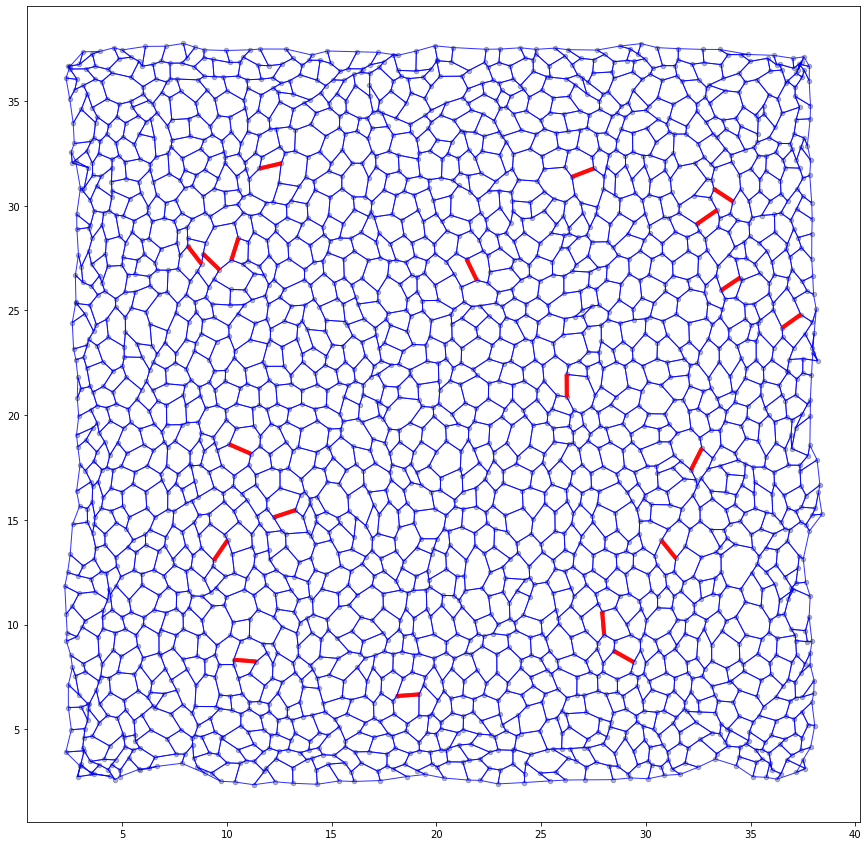

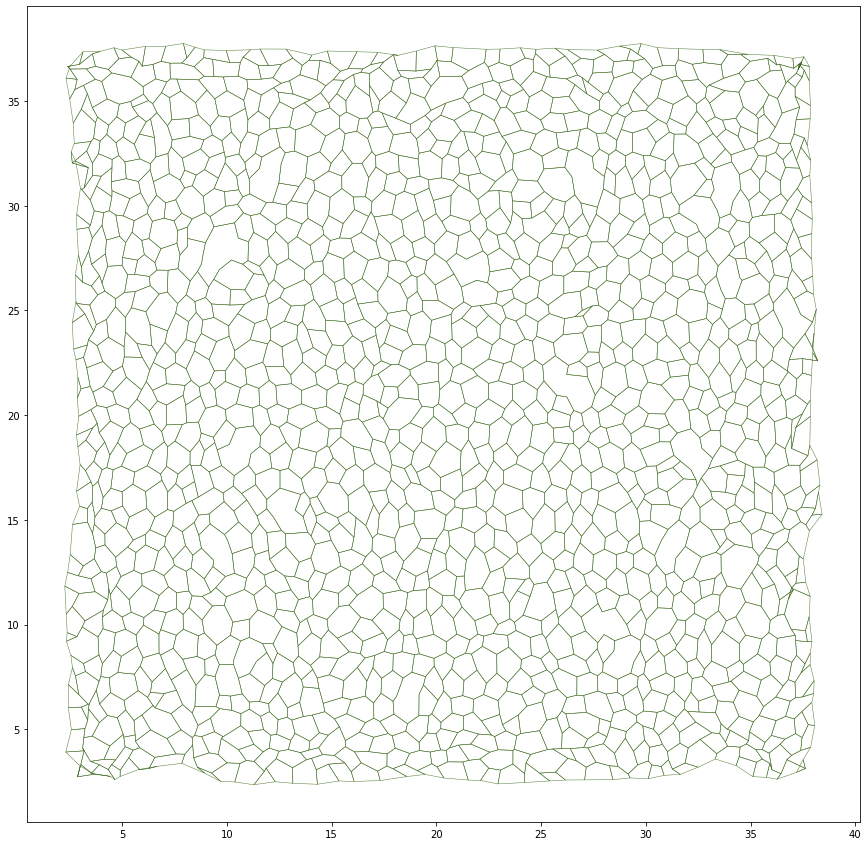

In [246]:
remove_edges_only(cellmap_H, "length", 20)

In [247]:
energyContributions_model.compute_energy(cellmap_H)
[cellmap_H, geom, model_H, history_H] = vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, endTime = 100)
    

Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!


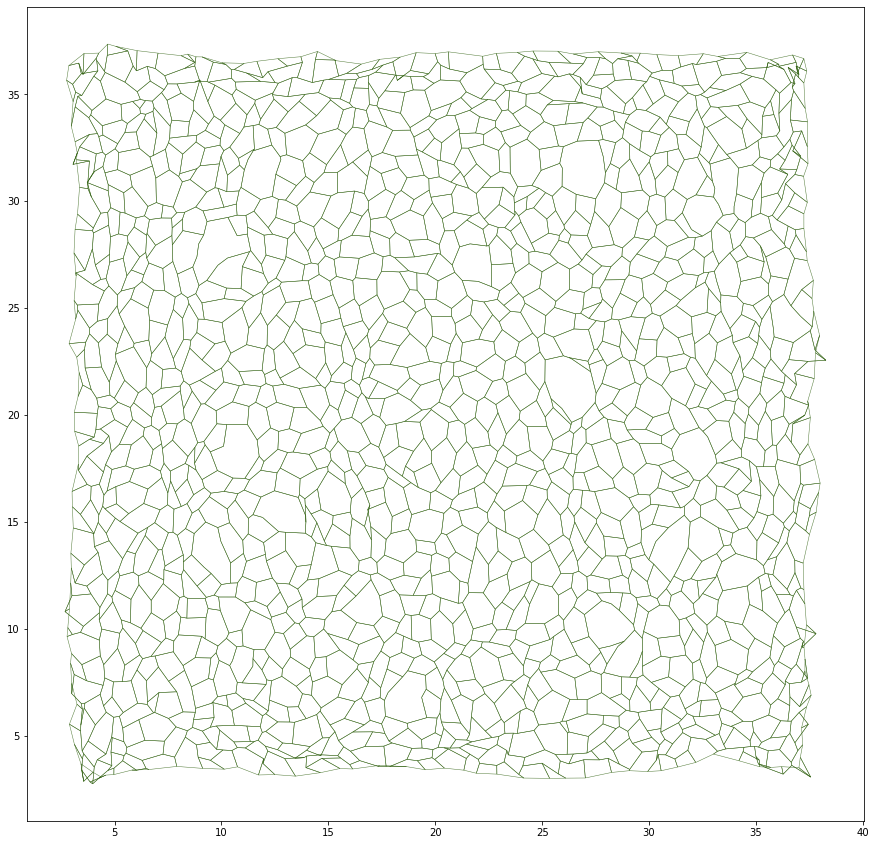

In [248]:
fig, ax = sheet_view(cellmap_H)
fig.set_size_inches((15, 15))

In [309]:
def remove_edge(cellmap, condition):
    # Find non-border edges
    edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap)
    
    # Choose edge to remove from non-border edges
    edge_to_remove = cellmap.edge_df[~cellmap.edge_df.index.isin(border_edges_indices)][condition].nlargest(1).index.tolist()
    
    srce, trgt = cellmap.edge_df.loc[edge_to_remove[0], ["srce", "trgt"]]
    opposites = cellmap.edge_df[
    (cellmap.edge_df["srce"] == trgt) & (cellmap.edge_df["trgt"] == srce)]
    opp_edge = opposites.index
    
    
    cellmap.edge_df["color_edges"] = 0
    cellmap.edge_df['edge_width'] = 1

    cellmap.edge_df.loc[edge_to_remove, "color_edges"] = 1
    cellmap.edge_df.loc[edge_to_remove, 'edge_width'] = 4

    specs = {
        'face': {
            'visible': False,
        },
        'edge': {
            'visible': True,
            'color': cellmap.edge_df["color_edges"],
            'colormap':'bwr',
            'width' : cellmap.edge_df['edge_width'],
        },
        'vert': {
            'visible': True,
            'color' : '#000a4b',
            's' : 20,
        }
    }



    fig, ax = sheet_view(cellmap_H, **specs)
    fig.set_size_inches((15, 15))


    
    # Remove the edge_to_remove from edge_df
    cellmap.edge_df = cellmap.edge_df[~cellmap.edge_df.index.isin(edge_to_remove)]
    cellmap.edge_df = cellmap.edge_df[~cellmap.edge_df.index.isin(opp_edge)]


    fig, ax = sheet_view(cellmap_H)
    fig.set_size_inches((15, 15))

       
    # Remove any unused vertices 
    #cellmap.vert_df = cellmap.vert_df.loc[remaining_verts]
    
    # Reset index and topology (adjust as needed)
    cellmap.reset_index()
    cellmap.reset_topo()
    
    # Update geometry
    geom.update_all(cellmap)
    
    return edge_to_remove
    

8
edge removed
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
1
edge removed
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
2
edge removed
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
3
edge removed
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
4
edge removed
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
5
edge removed
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
6
edge removed
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology changed!
Topology chan

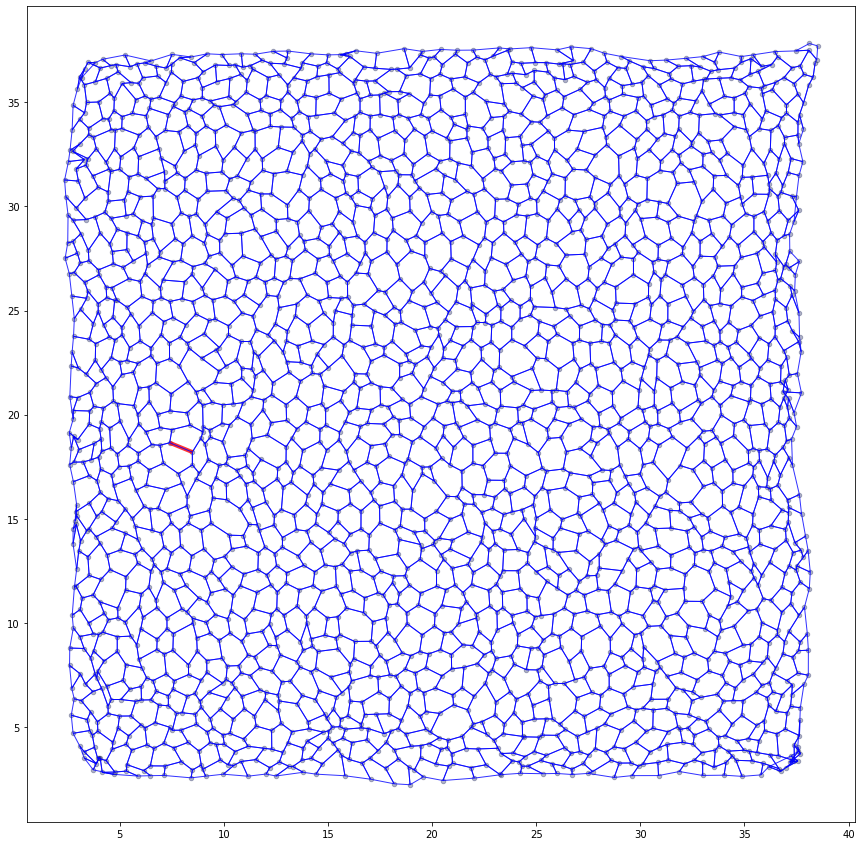

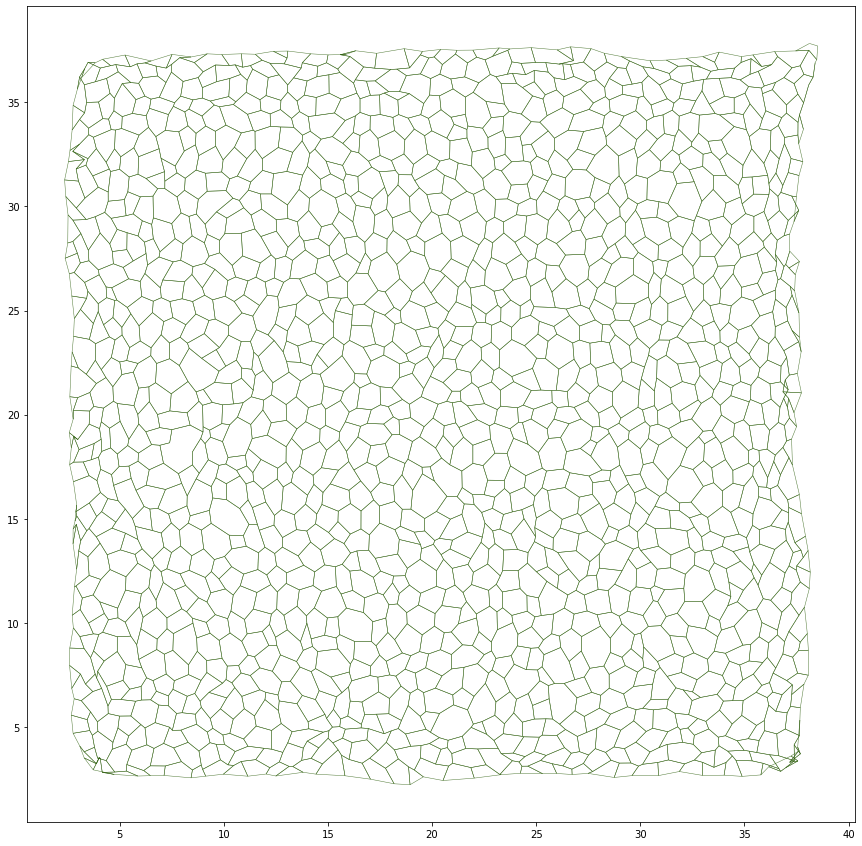

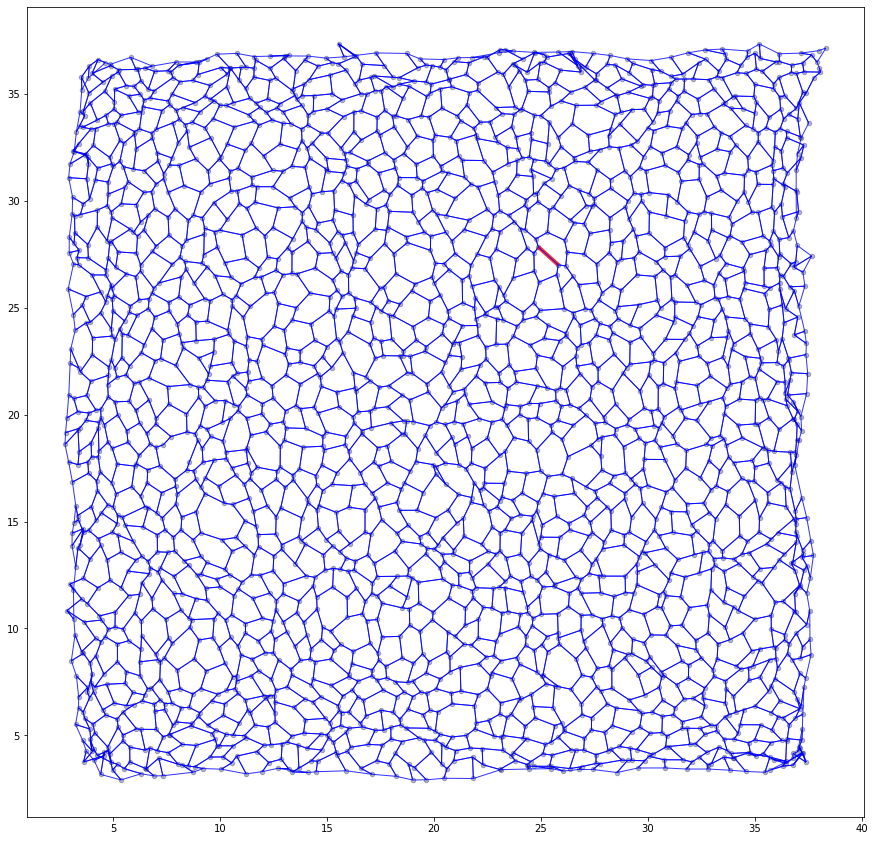

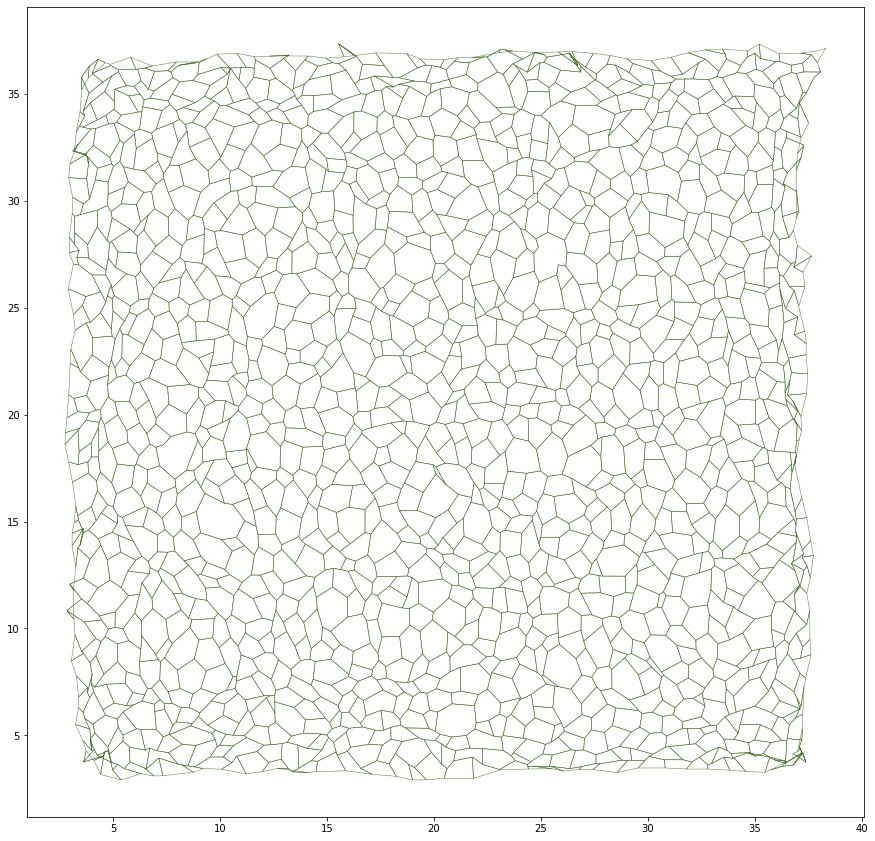

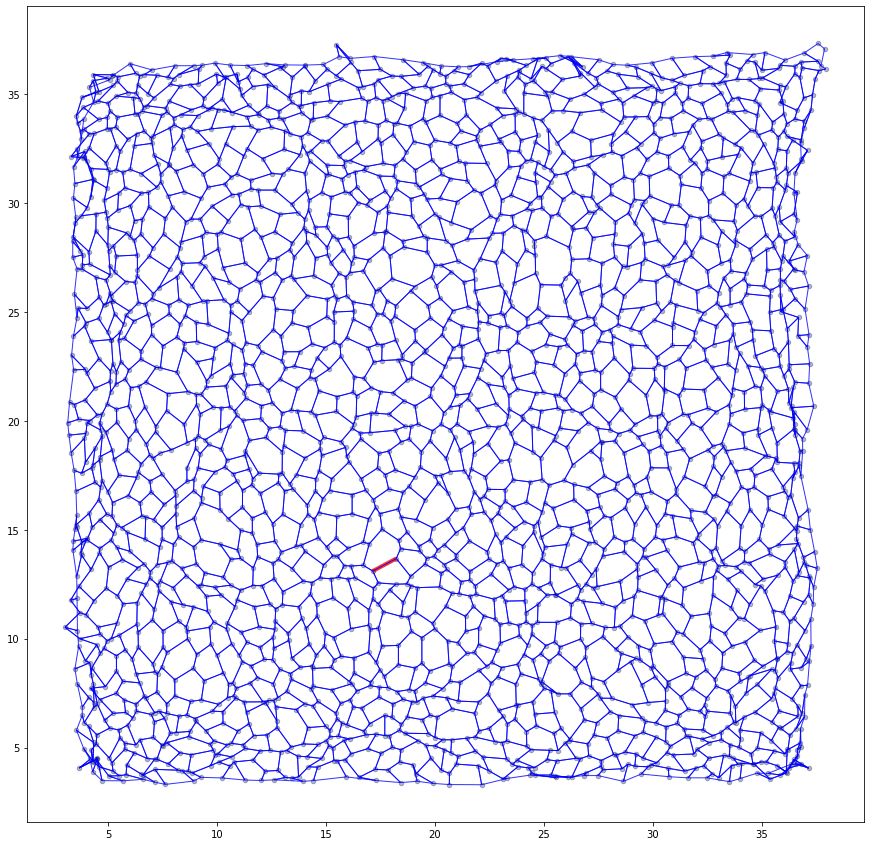

...

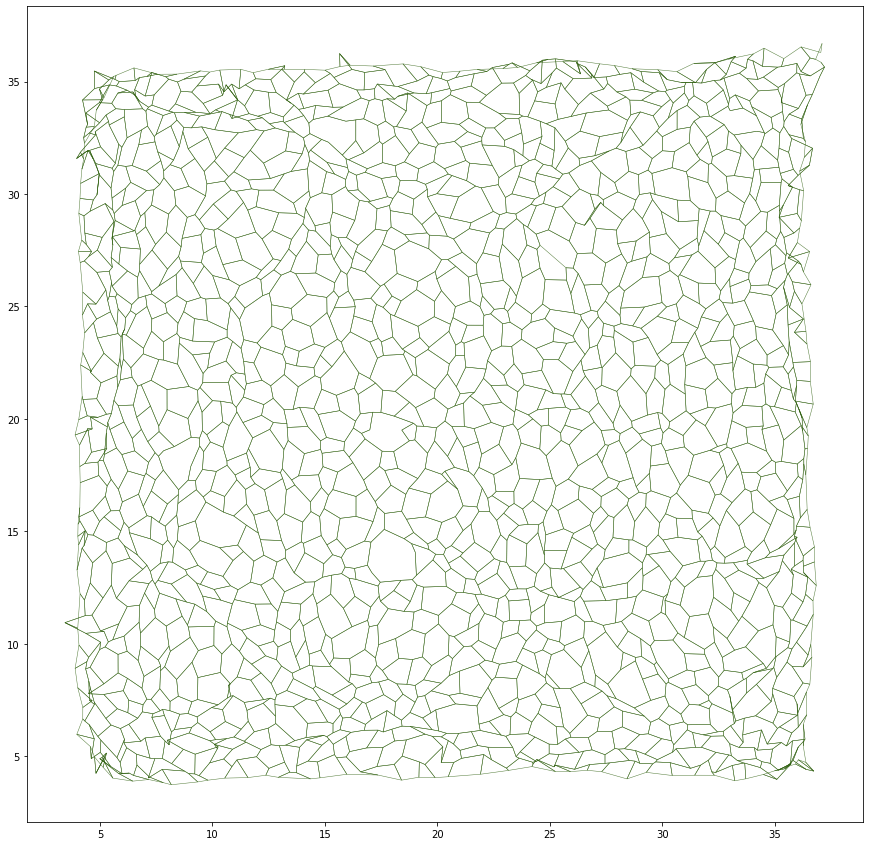

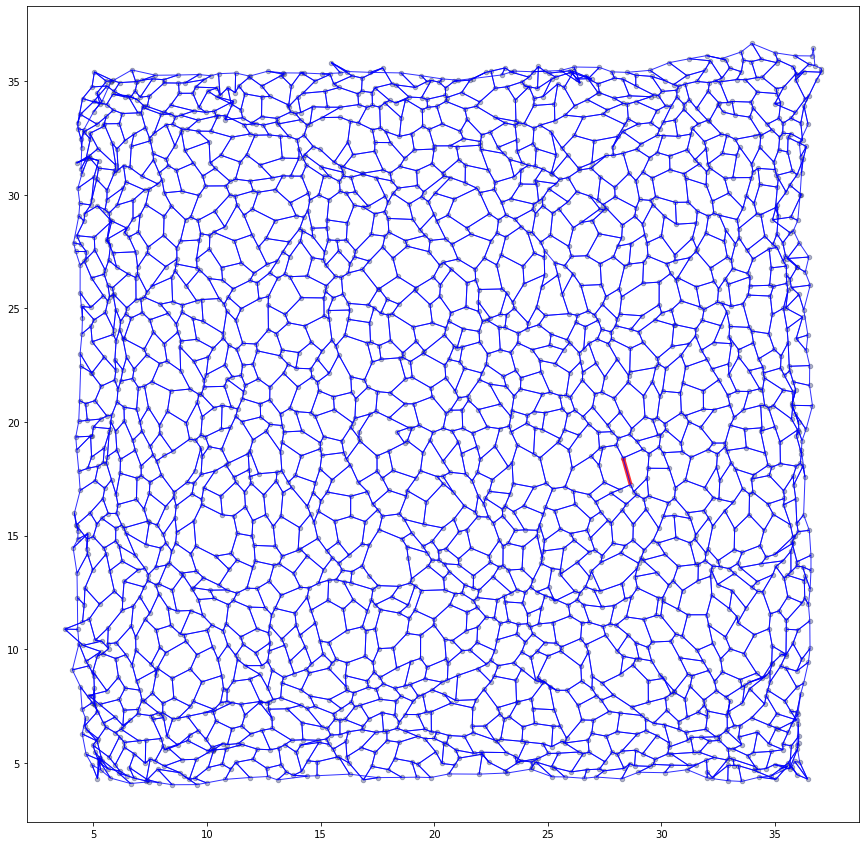

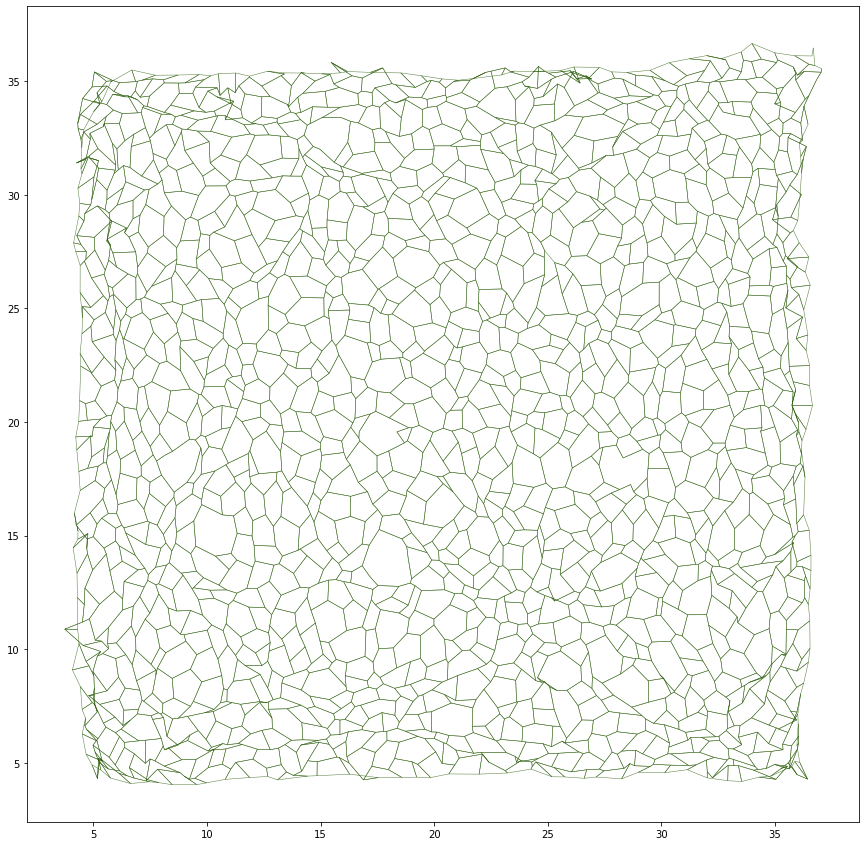

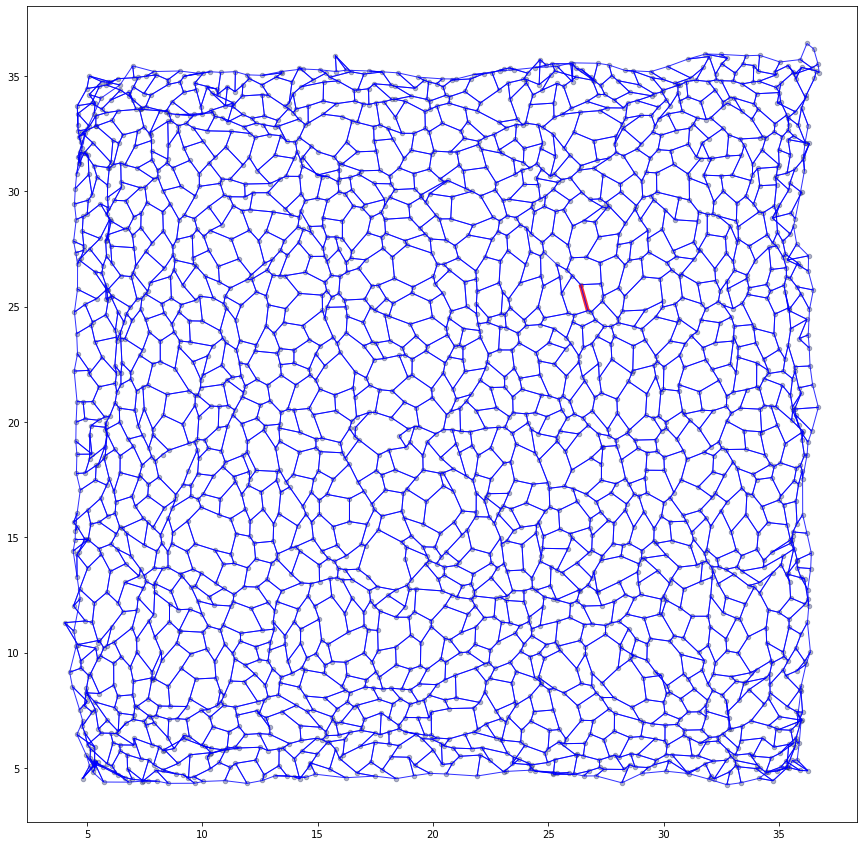

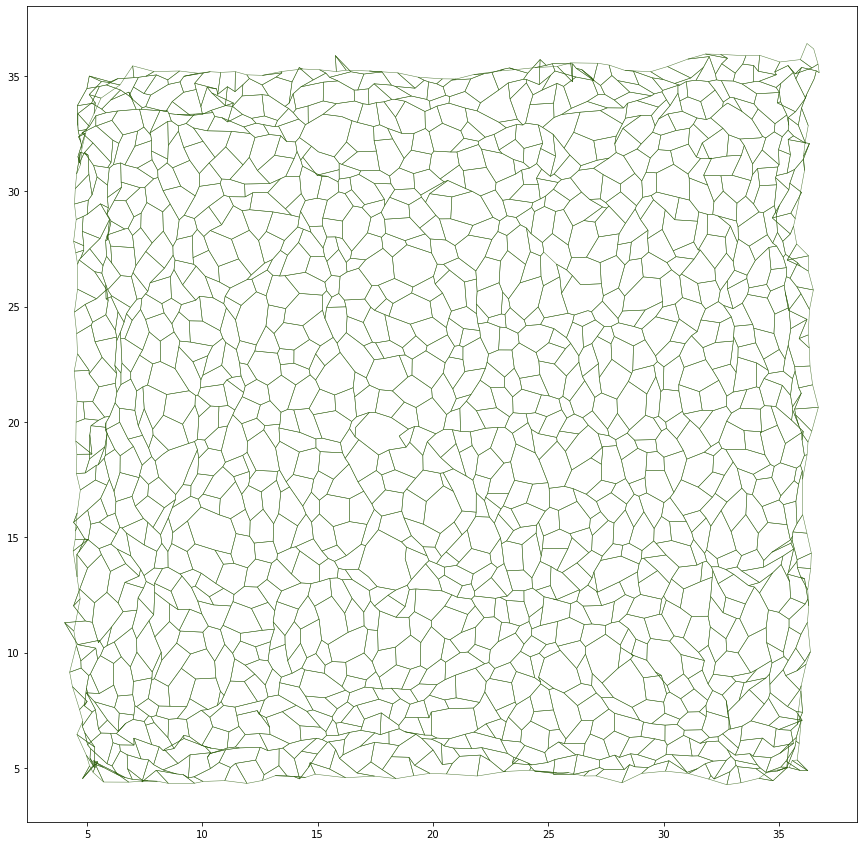

In [310]:
percent_to_select = 0.1

# Calculate the number of edges to select
num_to_select = int(percent_to_select/100 * len(cellmap_H.edge_df))
print(num_to_select)

# Iterate until the desired number of edges have been selected
selected_edges = set()

while len(selected_edges) < num_to_select:
    # Get a random edge index
    edge_to_remove = remove_edge(cellmap_H, "length")
    print('edge removed')
    selected_edges.add(edge_to_remove.index)
    
    #minimize energy
    energyContributions_model.compute_energy(cellmap_H)
    [cellmap_H, geom, model_H, history_H] = vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, endTime = 100)
    
    print(len(selected_edges))
    if len(selected_edges) == num_to_select:
        break



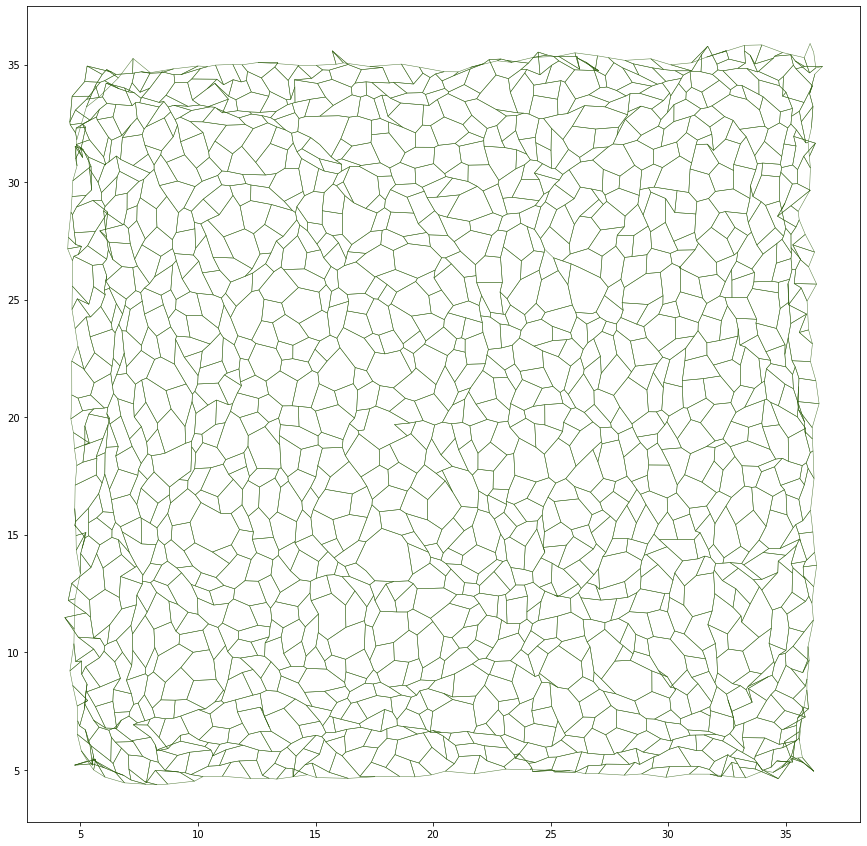

In [312]:
fig, ax = sheet_view(cellmap_H)
fig.set_size_inches((15, 15))

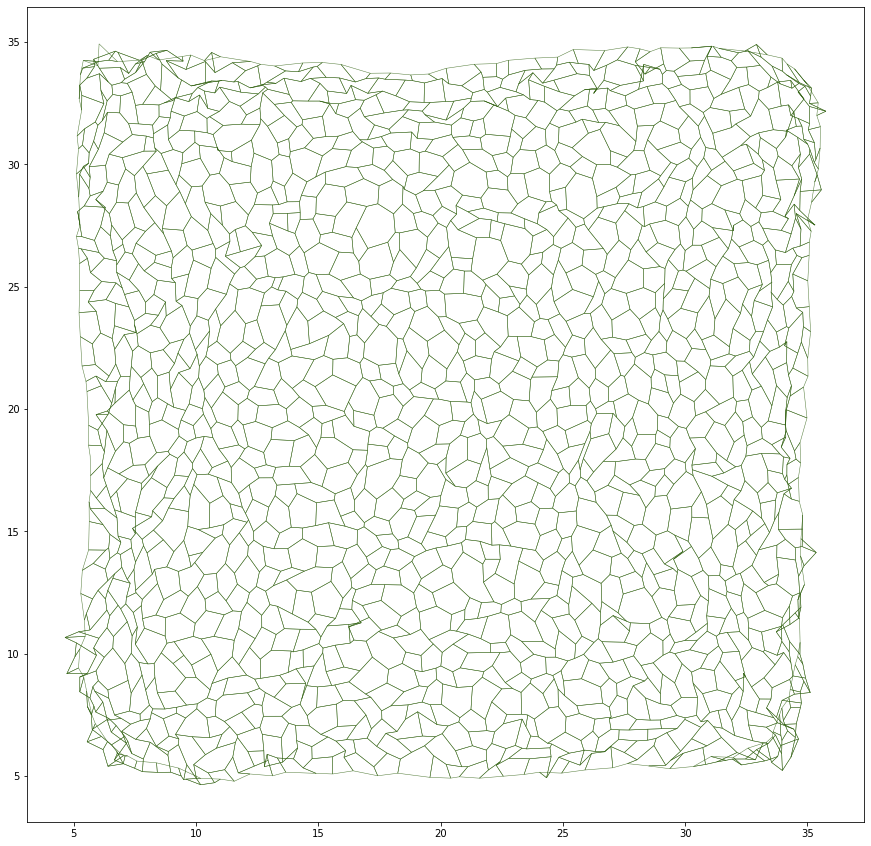

In [184]:
def apoptosis_one_FRC(cellmap, condition):
    
    # Find non-border edges
    edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap)
    
    # Choose edge to remove from non-border edges
    edge_to_remove = cellmap.edge_df[~cellmap.edge_df.index.isin(border_edges_indices)][condition].nlargest(1).index.tolist()
    
    srce, trgt = cellmap.edge_df.loc[edge_to_remove[0], ["srce", "trgt"]]
    opposites = cellmap.edge_df[
    (cellmap.edge_df["srce"] == trgt) & (cellmap.edge_df["trgt"] == srce)]
    opp_edge = opposites.index

    
    # Remove the edge_to_remove from edge_df
    cellmap.edge_df = cellmap.edge_df[~cellmap.edge_df.index.isin(edge_to_remove)]
    cellmap.edge_df = cellmap.edge_df[~cellmap.edge_df.index.isin(opp_edge)]


    # Reset index and topology (adjust as needed)
    cellmap.reset_index()
    cellmap.reset_topo()
    
    # Update geometry
    geom.update_all(cellmap)
    
    return edge_to_remove
    

In [ ]:
cellmap_H.edge_df["color_edges"] = 0
cellmap_H.edge_df['edge_width'] = 1

#cellmap_H.edge_df.loc[10, "color_edges"] = 1
#cellmap_H.edge_df.loc[10, 'edge_width'] = 4

specs = {
    'face': {
        'visible': False,
    },
    'edge': {
            'visible': True,
            'color': cellmap_H.edge_df["color_edges"],
            'colormap':'bwr',
            'width' : cellmap_H.edge_df['edge_width'],
    },
    'vert': {
        'visible': True,
        'color' : '#000a4b',
        's' : 20,
    }
}



fig, ax = sheet_view(cellmap_H, **specs)
fig.set_size_inches((15, 15))



In [ ]:
edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap_H)

In [ ]:
cellmap_H.edge_df.loc[edges_without_opposites_indices]["length"].nlargest(10).index

In [ ]:
chosen_edges = [3522, 1403, 325, 1209, 4150, 305, 6488, 5286, 4122, 2650, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11 , 12, 13]

In [ ]:
cellmap_H.edge_df = cellmap_H.edge_df.drop(chosen_edges)

In [ ]:
cellmap_H.edge_df["color_edges"] = 0
cellmap_H.edge_df['edge_width'] = 1

#cellmap_H.edge_df.loc[10, "color_edges"] = 1
#cellmap_H.edge_df.loc[10, 'edge_width'] = 4

specs = {
    'face': {
        'visible': False,
    },
    'edge': {
            'visible': True,
            'color': cellmap_H.edge_df["color_edges"],
            'colormap':'bwr',
            'width' : cellmap_H.edge_df['edge_width'],
    },
    'vert': {
        'visible': True,
        'color' : '#000a4b',
        's' : 20,
    }
}



fig, ax = sheet_view(cellmap_H, **specs)
fig.set_size_inches((15, 15))



### Apoptosis by merging vertices

4463
Topology changed!
Topology changed!
Topology changed!
5969
Topology changed!
Topology changed!
Topology changed!
3789
Topology changed!
Topology changed!
Topology changed!
7202
Topology changed!
Topology changed!
Topology changed!
3045
Topology changed!
Topology changed!
Topology changed!
5797
Topology changed!
Topology changed!
Topology changed!
2478
Topology changed!
Topology changed!
3444
Topology changed!
Topology changed!
Topology changed!
Topology changed!
4547
Topology changed!
Topology changed!
Topology changed!
Topology changed!
1490
Topology changed!
Topology changed!


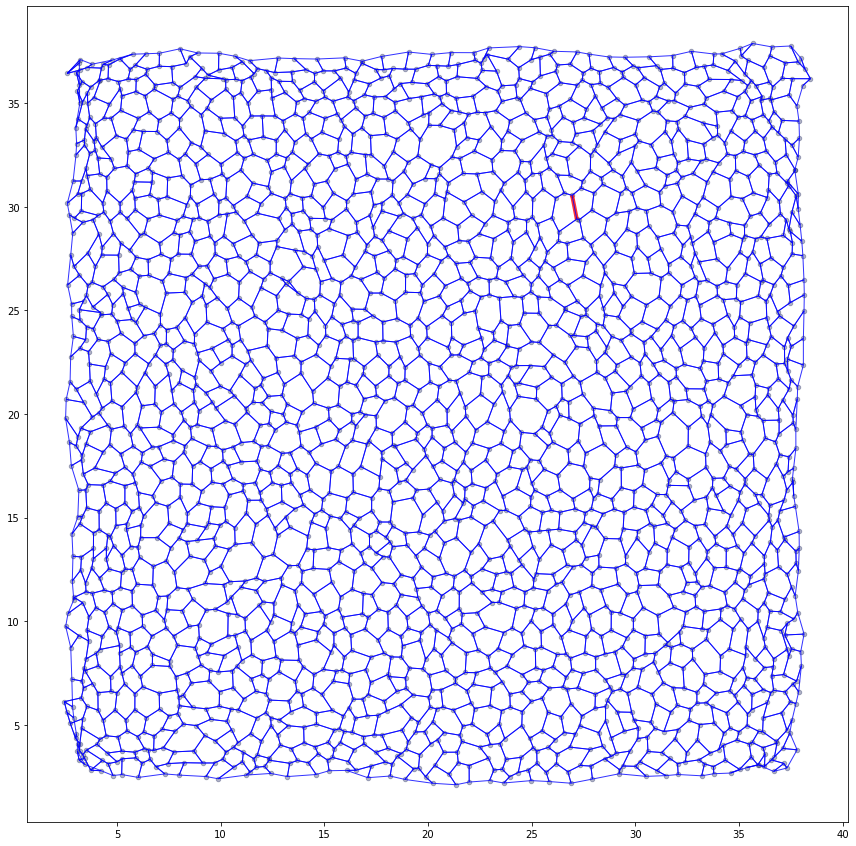

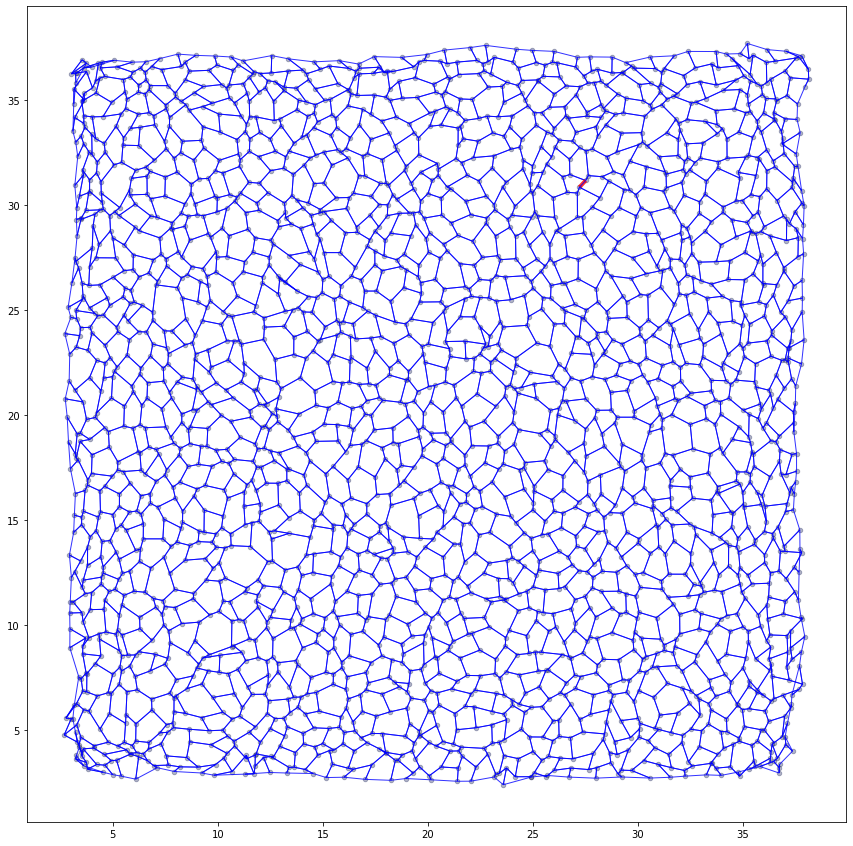

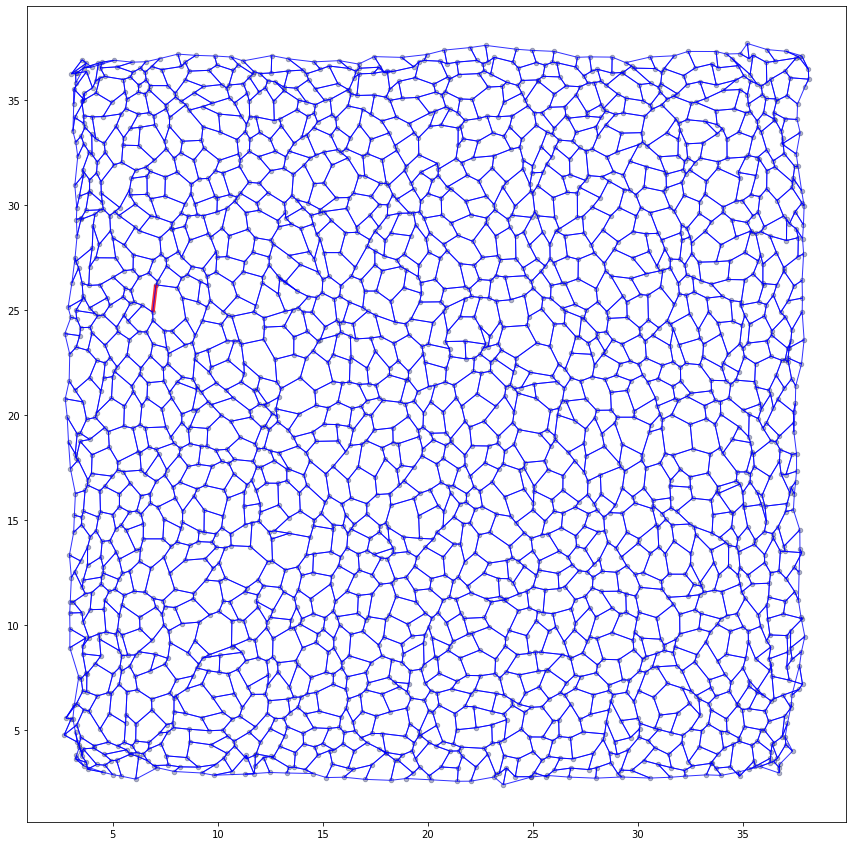

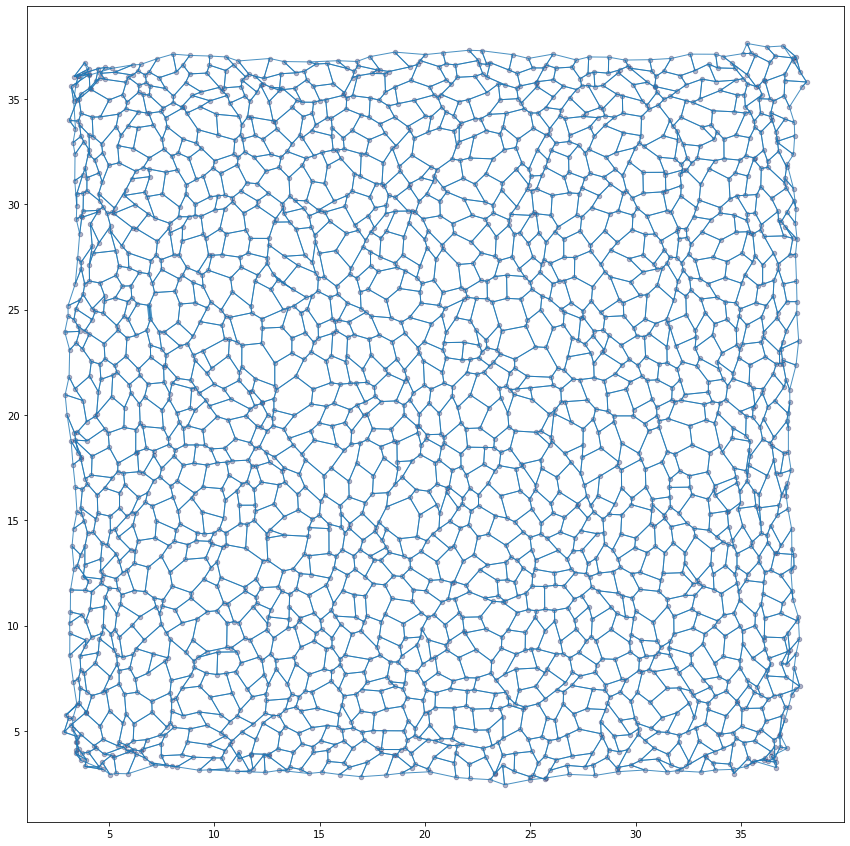

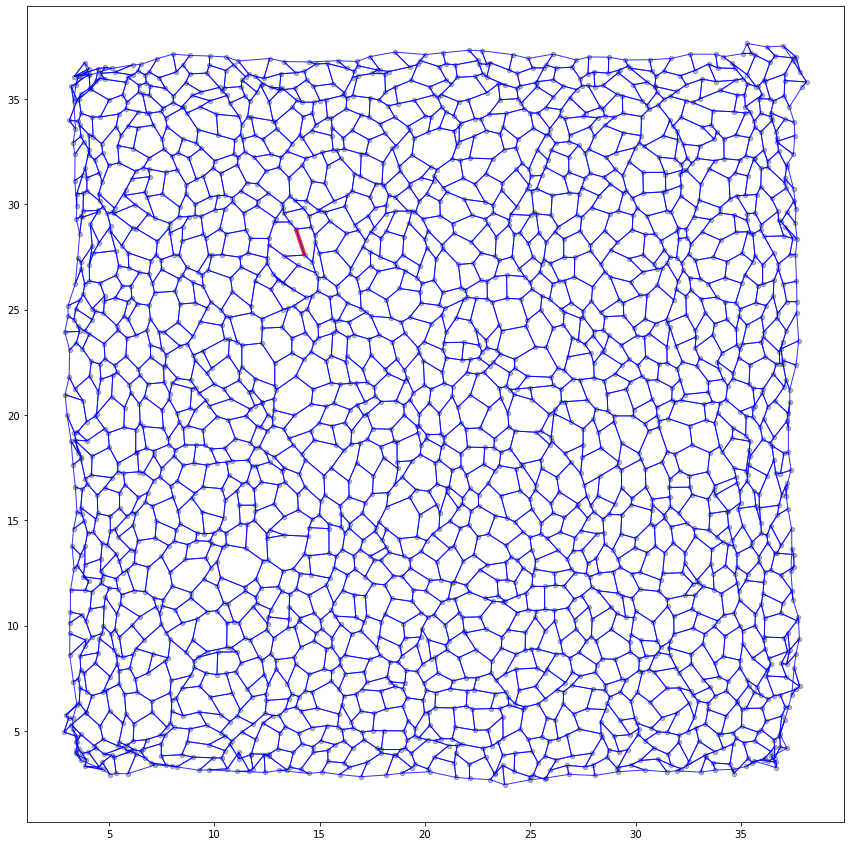

...

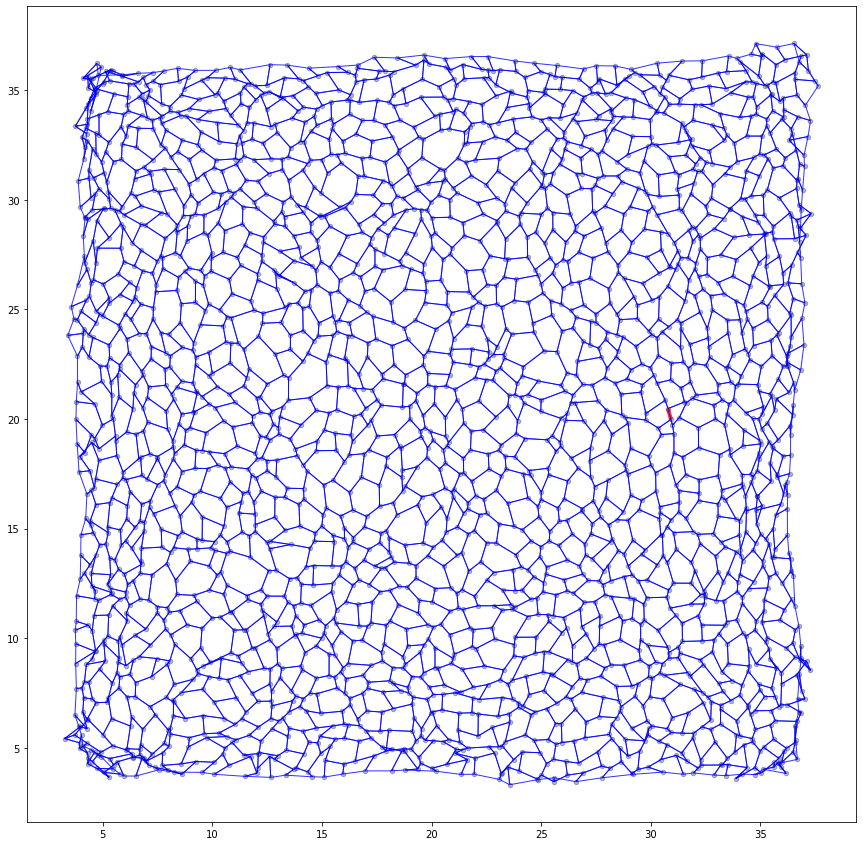

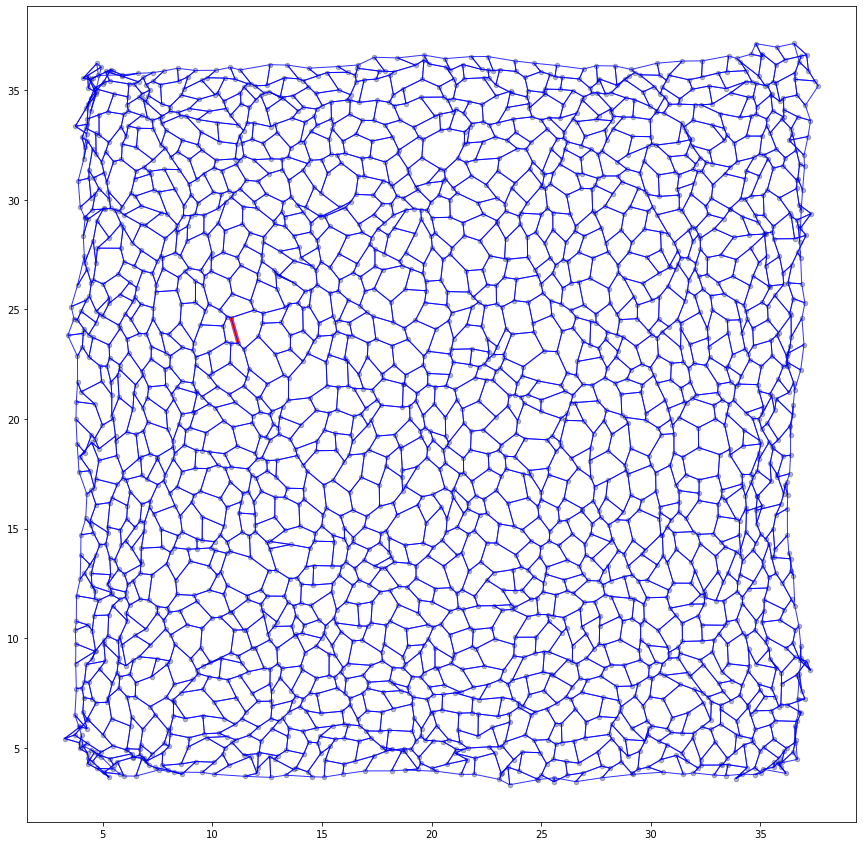

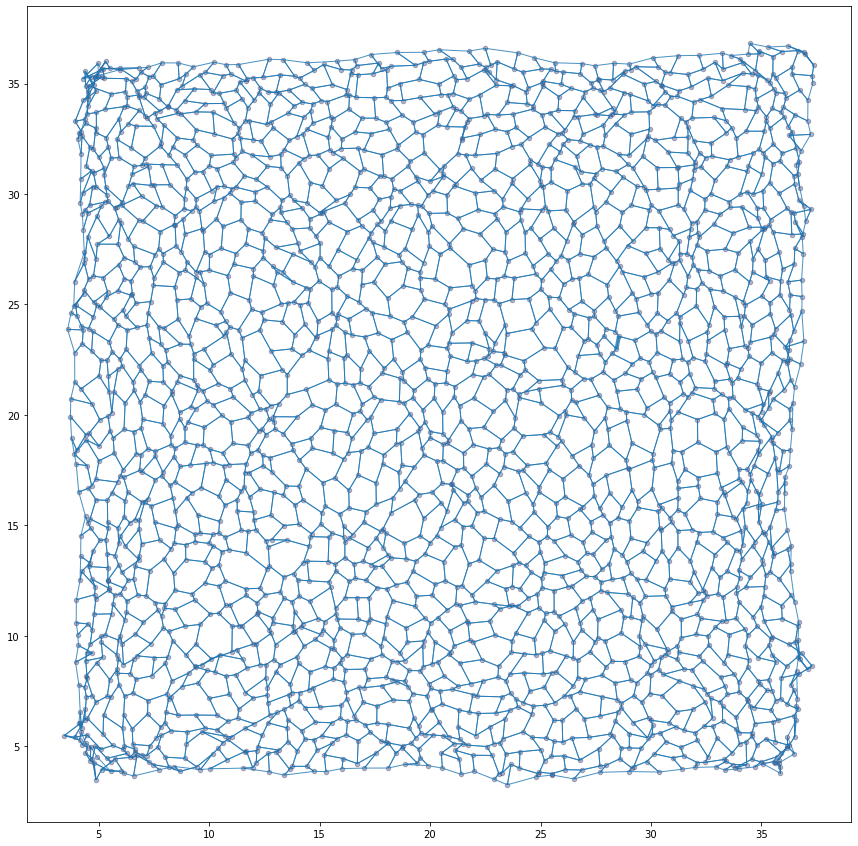

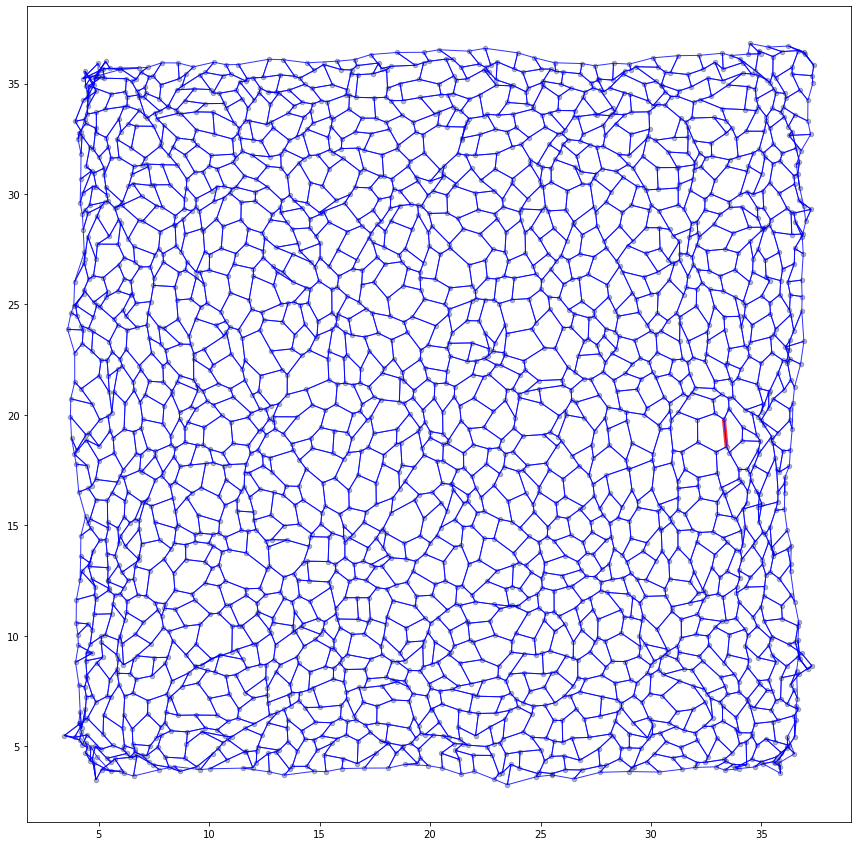

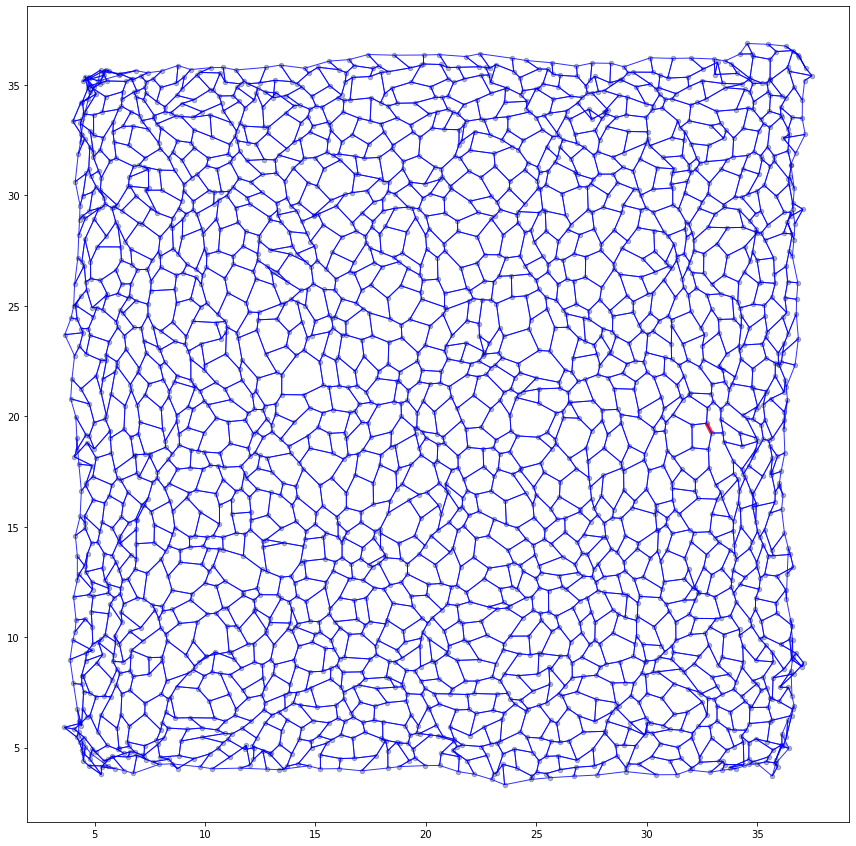

In [410]:
num_of_loops = 10

loops = set()

for i in range(1, num_of_loops + 1):
    
    edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap_H)

    edge_to_remove = cellmap_H.edge_df.loc[edges_without_opposites_indices]["length"].idxmax()
    print(edge_to_remove)
    
    cellmap_H.edge_df["color_edges"] = 0
    cellmap_H.edge_df['edge_width'] = 1

    cellmap_H.edge_df.loc[edge_to_remove, "color_edges"] = 1
    cellmap_H.edge_df.loc[edge_to_remove, 'edge_width'] = 4

    specs = {
        'face': {
            'visible': False,
        },
        'edge': {
            'visible': True,
            'color': cellmap_H.edge_df["color_edges"],
            'colormap':'bwr',
            'width' : cellmap_H.edge_df['edge_width'],
        },
        'vert': {
            'visible': True,
            'color' : '#000a4b',
            's' : 20,
        }
    }
    
    fig, ax = sheet_view(cellmap_H, **specs)
    fig.set_size_inches((15, 15))
    
    collapse_edge(cellmap_H, edge_to_remove, allow_two_sided=False)
    cellmap_H.update_rank()
    
    geom.update_all(cellmap_H)
    
    energyContributions_model.compute_energy(cellmap_H)
    vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, 40)
    
    fig, ax = sheet_view(cellmap_H, **specs)
    fig.set_size_inches((15, 15))
    
    loops.add(i)
    
    if len(loops) == num_of_loops:
        break

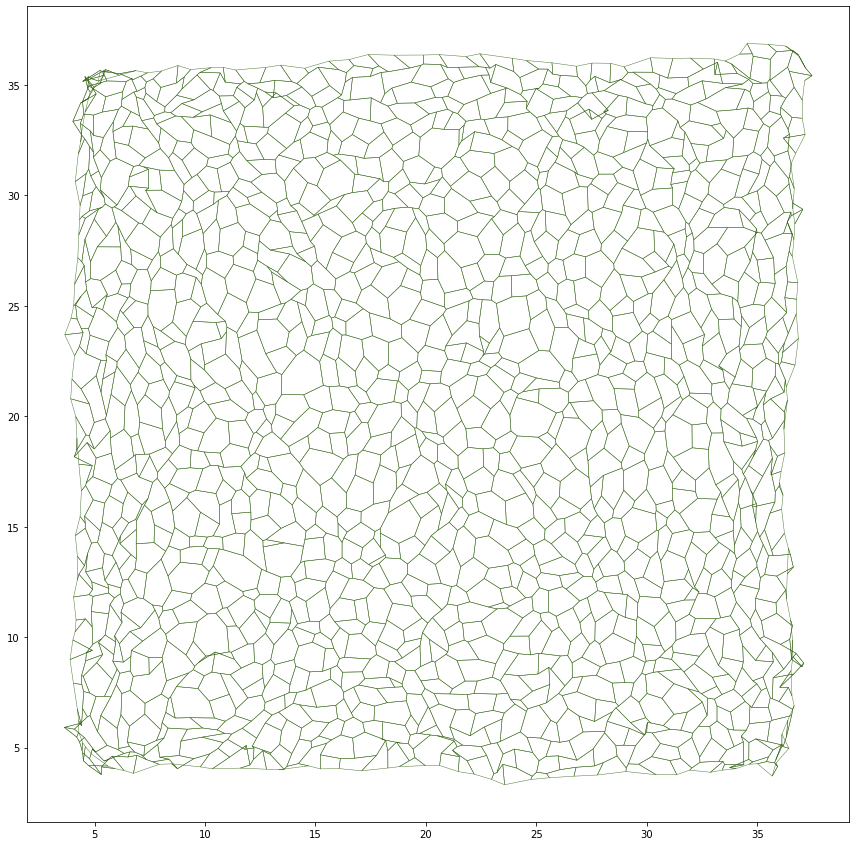

In [411]:
fig, ax = sheet_view(cellmap_H)
fig.set_size_inches((15, 15))

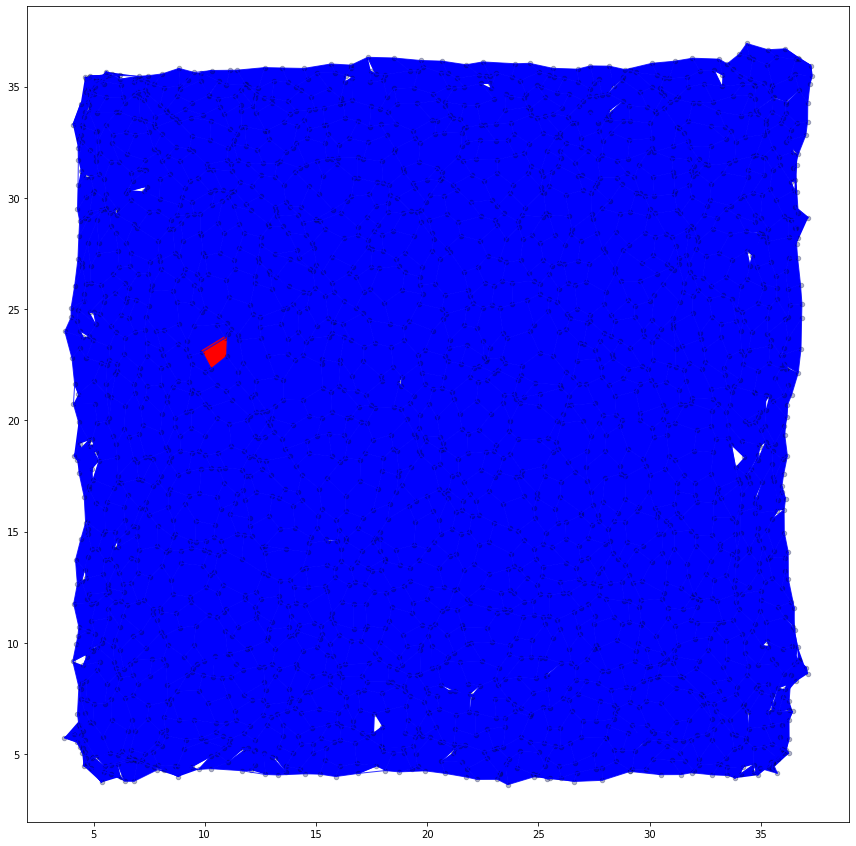

In [428]:
edges_without_opposites_indices, border_edges_indices = cellDivision.edges_list_without_opposites(cellmap_H)
edge_to_remove = cellmap_H.edge_df.loc[edges_without_opposites_indices]["length"].idxmax()

cellmap_H.edge_df["color_edges"] = 0
cellmap_H.edge_df['edge_width'] = 1

cellmap_H.edge_df.loc[edge_to_remove, "color_edges"] = 1
cellmap_H.edge_df.loc[edge_to_remove, 'edge_width'] = 4

cellmap_H.face_df["color_faces"] = 0
cellmap_H.face_df.loc[associated_face, "color_faces"] = 1

specs = {
    'face': {
        'visible': True,
        'color': cellmap_H.face_df["color_faces"],
        'colormap':'bwr',
    },
    'edge': {
        'visible': True,
        'color': cellmap_H.edge_df["color_edges"],
        'colormap':'bwr',
        'width' : cellmap_H.edge_df['edge_width'],
    },
    'vert': {
        'visible': True,
        'color' : '#000a4b',
        's' : 20,
    }
}
    
fig, ax = sheet_view(cellmap_H, **specs)
fig.set_size_inches((15, 15))

In [423]:
associated_face = cellmap_H.edge_df.loc[edge_to_remove]['face']


Topology changed!
Topology changed!


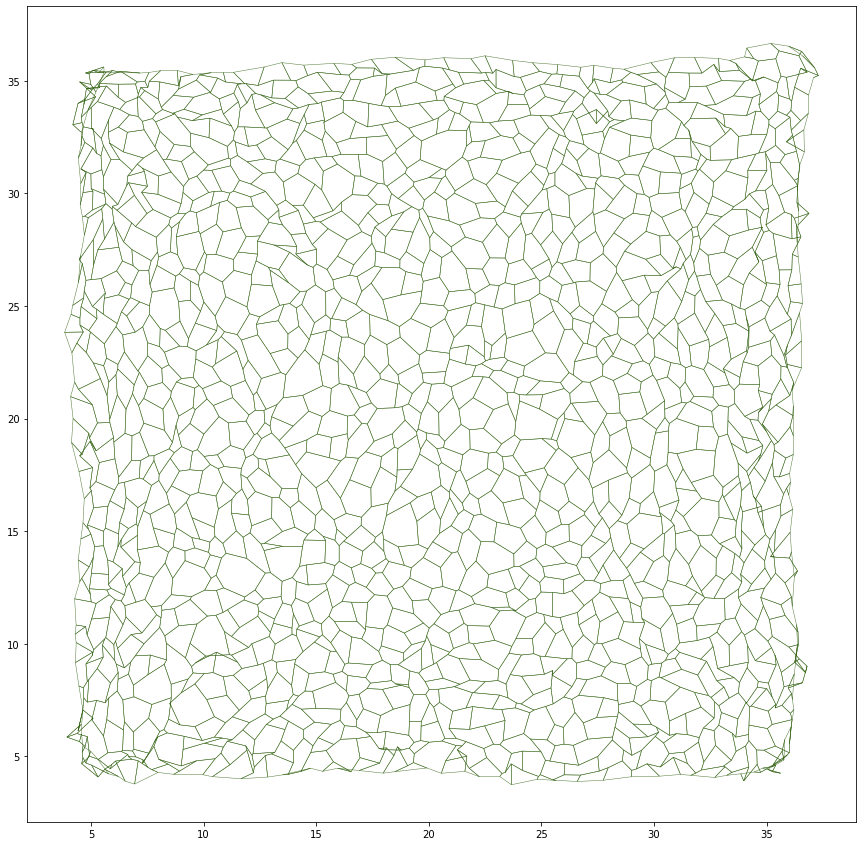

In [430]:
collapse_edge(cellmap_H, edge_to_remove, allow_two_sided=False)
cellmap_H.update_rank()
    
geom.update_all(cellmap_H)
    
energyContributions_model.compute_energy(cellmap_H)
vertexModel.solveEuler(cellmap_H, geom, energyContributions_model, 40)
    
fig, ax = sheet_view(cellmap_H, **specs)
fig.set_size_inches((15, 15))